# MS Data Preprocessing Pipeline

### Input

-   **metadata file:** `.tsv` file with samples as rows and variables as columns.

    Example:


    <span style="color:red"><sup>*necessary columns (use same column name)</sup></span>
    
<style>
/* Keep this once per notebook. It only tweaks colors for the 6th–7th columns. */
table.dataframe thead th:nth-child(6),
table.dataframe thead th:nth-child(5),
table.dataframe tbody td:nth-child(6),
table.dataframe tbody td:nth-child(5) { color: red}
</style>

<table class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th>label_ID</th>
      <th>group</th>
      <th>plate_position</th>
      <th>plate_nr</th>
      <th>sample_name</th>
      <th>sample_type</th>
      <th>study_ID</th>
      <th>timepoint</th>
    </tr>
  </thead>
  <tbody>
    <tr><td>4374572456</td><td>Intervention</td><td>A1</td><td>1</td><td>Plate1_A1</td><td>sample</td><td>1000-01</td><td>baseline</td></tr>
    <tr><td>4374596295</td><td>Intervention</td><td>A2</td><td>1</td><td>Plate1_A2</td><td>sample</td><td>1000-02</td><td>baseline</td></tr>
    <tr><td>4374586525</td><td>Control</td><td>B1</td><td>1</td><td>Plate1_B1</td><td>sample</td><td>1000-03</td><td>baseline</td></tr>
    <tr><td>4374578485</td><td>Control</td><td>B2</td><td>1</td><td>Plate1_B2</td><td>sample</td><td>1000-04</td><td>baseline</td></tr>
    <tr><td>4374552863</td><td>-</td><td>A1</td><td>2</td><td>Plate2_A1</td><td>QC</td><td>1000-05</td><td>baseline</td></tr>
    <tr><td>4374572494</td><td>Intervention</td><td>A2</td><td>2</td><td>Plate2_A2</td><td>sample</td><td>1000-01</td><td>day15</td></tr>
    <tr><td>4374562953</td><td>Intervention</td><td>B1</td><td>2</td><td>Plate2_B1</td><td>sample</td><td>1000-02</td><td>day15</td></tr>
    <tr><td>4374573958</td><td>Control</td><td>B2</td><td>2</td><td>Plate2_B2</td><td>sample</td><td>1000-03</td><td>day15</td></tr>
    <tr><td>4374582638</td><td>Control</td><td>A1</td><td>3</td><td>Plate3_A1</td><td>sample</td><td>1000-04</td><td>day15</td></tr>
    <tr><td>4374597831</td><td>-</td><td>A3</td><td>3</td><td>Plate3_A3</td><td>QC</td><td>1000-05</td><td>day15</td></tr>
  </tbody>
</table>


</br>
</br>

-   **proteomes file:** `.tsv` file with proteins as rows and samples as columns. Columns should contain information to reconstruct identifiers contained in the `sample_name` column of the metadata

    Example:

| <span style="color:red">protein</span> | .\\MSdata\\20250101_STUDY_AB_<span style="color:red">Plate1_A1</span>.mzML | .\\MSdata\\20250101_STUDY_AB_<span style="color:red">Plate1_A2</span>.mzML2 | .\\MSdata\\20250101_STUDY_AB_<span style="color:red">Plate1_B1</span>.mzML2 | .\\MSdata\\20250101_STUDY_AB_<span style="color:red">Plate1_B2</span>.mzML2 | .\\MSdata\\20250101_STUDY_AB_<span style="color:red">Plate2_A1</span>.mzML2 |
| ------------- | ------------------------------------------- | -------------------------------------------- | -------------------------------------------- | -------------------------------------------- | -------------------------------------------- |
| KV37_HUMAN    | 5,7341E+12                                  | 6,1284E+12                                   | 5,0213E+12                                   | 4,8762E+12                                   | 6,5028E+12                                   |
| LV469_HUMAN   | 8,27461E+11                                 | 7,90531E+11                                  | 9,18455E+11                                  | 7,33641E+11                                  | 8,74102E+11                                  |
| LV861_HUMAN   | 3,9178E+11                                  | 4,2315E+11                                   | 3,5026E+11                                   | 3,1189E+11                                   | 4,0097E+11                                   |
| LV460_HUMAN   | 413846                                      | 482193                                       | 428915                                       | 497330                                       | 455118                                       |
| LV746_HUMAN   | 1,07293E+13                                 | 9,7342E+12                                   | 1,20347E+13                                  | 1,01583E+13                                  | 9,9871E+12                                   |
| LV537_HUMAN   | 15278000000                                 | 13456000000                                  | 17824000000                                  | 16590000000                                  | 14932000000                                  |
| LV233_HUMAN   | 544526                                      | 536778                                       | 593104                                       | 521667                                       | 572684                                       |
| LV218_HUMAN   | 1,18547E+12                                 | 1,29471E+12                                  | 1,05864E+12                                  | 1,34255E+12                                  | 1,12633E+12                                  |
| LV316_HUMAN   | 1,87362E+12                                 | 2,04638E+12                                  | 1,76419E+12                                  | 1,90877E+12                                  | 1,73254E+12                                  |
| LV312_HUMAN   | 415467                                      | 501224                                       | 439772                                       | 462015                                       | 408299                                       |


### Loading data

In [22]:
import pandas as pd
import numpy as np
from MSprocessing.preprocessing.utils import load_proteomes, rename_columns_to_sample, merge_meta_proteome, get_sample_order, configure_fastai_local_tmp
from MSprocessing.preprocessing.missingness import extract_counts, filter_samples_by_missingness, filter_missingness, iter_filter_missingness
from MSprocessing.preprocessing.imputation import impute_minprob, impute_cf, impute_dae, impute_vae
from MSprocessing.preprocessing.normalization import normalize_sample, batch_correction
from MSprocessing.preprocessing.plots import plot_count_histogram, plot_protein_counts, plot_count_boxplot, plot_dynamic_range, plot_umap, plot_density_heatmap, plot_sample_box, plot_sample_means



In [23]:
#Load proteomes from a given TSV file path. 

#path : path to the TSV file containing proteome data
#clean_columns : iuf True, cleans column names by removing directory paths
#extension : removes this extension from the column names 


proteome = load_proteomes('./example_proteome.tsv', clean_columns=True, extension= '.mzML')
proteome

C:\Users\aben0177\Documents\git_projects\MSprocessing\MSprocessing\preprocessing\utils.py:74: FutureWarning:

errors='ignore' is deprecated and will raise in a future version. Use to_numeric without passing `errors` and catch exceptions explicitly instead



,protein,20250101_STUDY_AB_plate1_A6,20250101_STUDY_AB_plate1_A7,20250101_STUDY_AB_plate1_A8,20250101_STUDY_AB_plate1_A9,20250101_STUDY_AB_plate1_A10,20250101_STUDY_AB_plate1_A11,20250101_STUDY_AB_plate1_A12,20250101_STUDY_AB_plate1_B1,20250101_STUDY_AB_plate1_B2,...,20250101_STUDY_AB_plate2_E5,20250101_STUDY_AB_plate2_E6,20250101_STUDY_AB_plate2_E7,20250101_STUDY_AB_plate2_E8,20250101_STUDY_AB_plate2_E9,20250101_STUDY_AB_plate2_E10,20250101_STUDY_AB_plate2_E11,20250101_STUDY_AB_plate2_E12,20250101_STUDY_AB_plate2_F1,20250101_STUDY_AB_plate2_F2
0,A0A075B6H9,"294,202.000",NaN,NaN,"2,833,010.000","469,337.000",NaN,NaN,"708,579.000",NaN,...,"1,463,820.000","1,829,170.000","67,938.100",NaN,NaN,"1,179,500.000","170,391.000","217,827.000","338,008.000",NaN
1,A0A075B6I9,NaN,"293,076,726.660",NaN,"221,998,872.857",NaN,"91,114,616.909",NaN,NaN,NaN,...,"292,739,197.802",NaN,"222,552,525.795","247,085,056.967","451,082,467.676","247,859,428.310","231,512,744.951","188,207,665.822","84,620,691.247","126,550,377.929"
2,A0A075B6J1,"682,918.210","818,668.127",NaN,"1,412,210.016","3,827,441.968","554,451.105","1,720,504.001",NaN,"1,220,383.026",...,NaN,NaN,"792,516.482","727,471.317","6,556,386.542","1,628,697.957",NaN,"8,301,967.012",NaN,NaN
3,A0A075B6J2,"430,945.752",NaN,NaN,"909,830.840","1,137,261.937","446,561.857",NaN,NaN,"364,354.186",...,"376,272.068","534,238.675","1,832,649.780","7,942,805.341","483,416.237","458,934.373","678,000.351",NaN,"648,328.314","1,037,361.489"
4,A0A075B6J9,"25,116,422.175",NaN,NaN,"40,141,620.667",NaN,"53,241,698.355","16,182,367.609","41,597,974.014","12,508,256.814",...,"6,113,380.712","31,008,476.031",NaN,NaN,"52,177,546.867","37,192,537.292","16,346,478.417",NaN,"31,336,374.940","15,335,697.103"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"1,268",Q9Y6C2,"19,267.409","13,246.008",NaN,"6,399.877","12,608.051","20,121.298",NaN,NaN,"25,697.882",...,"9,408.636",NaN,"10,155.984","9,358.882",NaN,"8,250.628",NaN,"10,997.668","11,436.988","15,213.806"
"1,269",Q9Y6E0,"392,137.546","95,810.199","130,313.647","245,176.755","277,321.443","477,055.143","418,297.035","143,353.644","260,084.131",...,NaN,"201,683.918","106,203.247","213,561.810","181,350.391",NaN,NaN,"192,456.453","160,164.202","192,171.943"
"1,270",Q9Y6N7,NaN,"10,401.345","12,346.251","8,926.303","11,132.321",NaN,"11,833.937","8,022.108","10,650.190",...,NaN,"9,528.868","9,999.714",NaN,"8,941.279","9,926.209","10,493.583","8,149.919","14,327.218","13,461.093"
"1,271",Q9Y6R7,"10,508,494.815",NaN,"4,609,906.885","18,080,088.206","8,694,106.703","4,134,377.314","3,889,082.636","5,640,642.964","4,611,320.779",...,"12,463,358.129",NaN,"6,863,217.269","5,186,621.120","11,594,475.737","4,640,848.609","12,814,266.065","41,482,980.586","2,790,873.385",NaN


In [24]:
#Rename selected columns of a proteome table to their derived sample IDs.
#The default sample ID is constructed as "<plate_nr>_<position>",
#assuming that these are respectively at positions -2 and -1`.

#df : input dataframe (with cleaned column names)
#sep : str, default "_", separator used to split column names
#keep_parts : list, parts to keep as the sample name to match metadata (eg. plate number and position)

proteome = rename_columns_to_sample(
    proteome,
    sep="_",
    keep_parts= [-2, -1]
)

proteome

Column 'protein' has no separator → kept as is.


,protein,plate1_A6,plate1_A7,plate1_A8,plate1_A9,plate1_A10,plate1_A11,plate1_A12,plate1_B1,plate1_B2,...,plate2_E5,plate2_E6,plate2_E7,plate2_E8,plate2_E9,plate2_E10,plate2_E11,plate2_E12,plate2_F1,plate2_F2
0,A0A075B6H9,"294,202.000",NaN,NaN,"2,833,010.000","469,337.000",NaN,NaN,"708,579.000",NaN,...,"1,463,820.000","1,829,170.000","67,938.100",NaN,NaN,"1,179,500.000","170,391.000","217,827.000","338,008.000",NaN
1,A0A075B6I9,NaN,"293,076,726.660",NaN,"221,998,872.857",NaN,"91,114,616.909",NaN,NaN,NaN,...,"292,739,197.802",NaN,"222,552,525.795","247,085,056.967","451,082,467.676","247,859,428.310","231,512,744.951","188,207,665.822","84,620,691.247","126,550,377.929"
2,A0A075B6J1,"682,918.210","818,668.127",NaN,"1,412,210.016","3,827,441.968","554,451.105","1,720,504.001",NaN,"1,220,383.026",...,NaN,NaN,"792,516.482","727,471.317","6,556,386.542","1,628,697.957",NaN,"8,301,967.012",NaN,NaN
3,A0A075B6J2,"430,945.752",NaN,NaN,"909,830.840","1,137,261.937","446,561.857",NaN,NaN,"364,354.186",...,"376,272.068","534,238.675","1,832,649.780","7,942,805.341","483,416.237","458,934.373","678,000.351",NaN,"648,328.314","1,037,361.489"
4,A0A075B6J9,"25,116,422.175",NaN,NaN,"40,141,620.667",NaN,"53,241,698.355","16,182,367.609","41,597,974.014","12,508,256.814",...,"6,113,380.712","31,008,476.031",NaN,NaN,"52,177,546.867","37,192,537.292","16,346,478.417",NaN,"31,336,374.940","15,335,697.103"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"1,268",Q9Y6C2,"19,267.409","13,246.008",NaN,"6,399.877","12,608.051","20,121.298",NaN,NaN,"25,697.882",...,"9,408.636",NaN,"10,155.984","9,358.882",NaN,"8,250.628",NaN,"10,997.668","11,436.988","15,213.806"
"1,269",Q9Y6E0,"392,137.546","95,810.199","130,313.647","245,176.755","277,321.443","477,055.143","418,297.035","143,353.644","260,084.131",...,NaN,"201,683.918","106,203.247","213,561.810","181,350.391",NaN,NaN,"192,456.453","160,164.202","192,171.943"
"1,270",Q9Y6N7,NaN,"10,401.345","12,346.251","8,926.303","11,132.321",NaN,"11,833.937","8,022.108","10,650.190",...,NaN,"9,528.868","9,999.714",NaN,"8,941.279","9,926.209","10,493.583","8,149.919","14,327.218","13,461.093"
"1,271",Q9Y6R7,"10,508,494.815",NaN,"4,609,906.885","18,080,088.206","8,694,106.703","4,134,377.314","3,889,082.636","5,640,642.964","4,611,320.779",...,"12,463,358.129",NaN,"6,863,217.269","5,186,621.120","11,594,475.737","4,640,848.609","12,814,266.065","41,482,980.586","2,790,873.385",NaN


In [25]:
#save preprocessed data
proteome.to_pickle("../tests/loaded_proteome.pkl")

In [26]:
#load metadata
meta = pd.read_csv("./example_meta.tsv", sep="\t", na_values=["NA"])
index_cols = meta.columns.tolist()
meta

,label_id,group,AL_kode,plate_position,plate_nr,sample_name,sample_type,study_ID,timepoint
0,"4,083,906,373",Intervention,"100,005",A6,plate1,plate1_A6,sample,67.000,day_15
1,"4,083,918,930",Intervention,"100,006",A7,plate1,plate1_A7,sample,34.000,day_0
2,"4,083,982,663",Intervention,"100,007",A8,plate1,plate1_A8,sample,63.000,day_0
3,"4,083,907,917",Control,"100,008",A9,plate1,plate1_A9,sample,16.000,day_15
4,"4,083,985,725",Intervention,"100,009",A10,plate1,plate1_A10,sample,79.000,day_0
...,...,...,...,...,...,...,...,...,...
148,"4,083,996,660",Control,"100,153",E10,plate2,plate2_E10,sample,57.000,day_0
149,"4,083,980,445",Intervention,"100,154",E11,plate2,plate2_E11,sample,79.000,day_15
150,"4,083,966,190",Intervention,"100,155",E12,plate2,plate2_E12,sample,35.000,day_15
151,"4,083,947,093",Control,"100,156",F1,plate2,plate2_F1,sample,45.000,day_15


In [27]:
#Merge metadata and proteome data by matching sample identifiers.

#meta : metadata table containing a sample identifier column.
#proteome : proteome table with sample identifiers as a column.
#meta_id_col : column in `meta` that identifies samples.
#proteome_id_col : column in `proteome` that identifies proteins.

merged = merge_meta_proteome(
    meta, 
    proteome, 
    meta_id_col="sample_name", 
    proteome_id_col="protein")
merged

,,,,,,,,,A0A075B6H9,A0A075B6I9,A0A075B6J1,A0A075B6J2,A0A075B6J9,A0A075B6K0,A0A075B6K2,A0A075B6K4,A0A075B6K5,A0A075B6K6,...,Q9Y608,Q9Y613,Q9Y624,Q9Y646,Q9Y696,Q9Y6C2,Q9Y6E0,Q9Y6N7,Q9Y6R7,Q9Y6Z7
label_id,group,AL_kode,plate_position,plate_nr,sample_name,sample_type,study_ID,timepoint,,,,,,,,,,,,,,,,,,,,,
"4,083,906,373",Intervention,"100,005",A6,plate1,plate1_A6,sample,67.000,day_15,"294,202.000",NaN,"682,918.210","430,945.752","25,116,422.175","7,918,193.726","171,889.710","63,513,594.548",NaN,"182,517.760",...,"149,063.484","237,043.247","1,003,227.278",NaN,"101,462.211","19,267.409","392,137.546",NaN,"10,508,494.815",NaN
"4,083,918,930",Intervention,"100,006",A7,plate1,plate1_A7,sample,34.000,day_0,NaN,"293,076,726.660","818,668.127",NaN,NaN,"11,955,513.135","1,533,988.325",NaN,"146,908,921.499","106,546.706",...,NaN,"108,717.927","548,204.233","34,368.248",NaN,"13,246.008","95,810.199","10,401.345",NaN,"7,335,606.761"
"4,083,982,663",Intervention,"100,007",A8,plate1,plate1_A8,sample,63.000,day_0,NaN,NaN,NaN,NaN,NaN,"14,172,224.197","482,314.326","83,715,162.668","270,841,985.854",NaN,...,NaN,"106,148.783","456,074.550","51,490.043","121,201.078",NaN,"130,313.647","12,346.251","4,609,906.885","3,462,412.937"
"4,083,907,917",Control,"100,008",A9,plate1,plate1_A9,sample,16.000,day_15,"2,833,010.000","221,998,872.857","1,412,210.016","909,830.840","40,141,620.667",NaN,"697,552.114","30,442,279.168",NaN,"122,473.705",...,"60,125.305",NaN,"805,993.686","68,049.657","182,200.531","6,399.877","245,176.755","8,926.303","18,080,088.206","5,566,103.169"
"4,083,985,725",Intervention,"100,009",A10,plate1,plate1_A10,sample,79.000,day_0,"469,337.000",NaN,"3,827,441.968","1,137,261.937",NaN,"34,872,972.802","1,022,214.915","27,769,234.523",NaN,"138,111.165",...,"86,549.910",NaN,"1,206,105.644",NaN,NaN,"12,608.051","277,321.443","11,132.321","8,694,106.703",NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"4,083,996,660",Control,"100,153",E10,plate2,plate2_E10,sample,57.000,day_0,"1,179,500.000","247,859,428.310","1,628,697.957","458,934.373","37,192,537.292","20,351,718.207","1,054,577.877","33,183,260.705","218,089,266.820","82,473.322",...,NaN,"133,029.011","336,768.292","106,217.130","107,323.963","8,250.628",NaN,"9,926.209","4,640,848.609","7,943,993.102"
"4,083,980,445",Intervention,"100,154",E11,plate2,plate2_E11,sample,79.000,day_15,"170,391.000","231,512,744.951",NaN,"678,000.351","16,346,478.417","46,677,608.132","2,444,216.507","141,898,085.785","240,580,769.740","183,008.111",...,"184,850.866",NaN,"808,337.972","70,474.461","146,285.209",NaN,NaN,"10,493.583","12,814,266.065","14,465,528.859"
"4,083,966,190",Intervention,"100,155",E12,plate2,plate2_E12,sample,35.000,day_15,"217,827.000","188,207,665.822","8,301,967.012",NaN,NaN,"32,345,478.652","417,322.314",NaN,"234,449,191.477","32,193.978",...,"389,474.609","115,225.633","229,108.865",NaN,NaN,"10,997.668","192,456.453","8,149.919","41,482,980.586","13,814,423.372"


In [28]:
#Count proteins per sample and plot a bar chart
#df : long-format dataframe with columns 'sample_name', 'sample_type'.

plot_protein_counts(merged)

In [29]:
#Plot histogram of protein counts per sample with boxplot margins.
#df : long-format dataframe with columns 'sample_name', 'sample_type'.

plot_count_histogram(merged)

### Missingness Handling

In [30]:
#Plot boxplot of missing proteins counts sample.
#df : long-format dataframe.

plot_count_boxplot(merged)

In [31]:
#Filter proteome dataframe by excluding samples whose protein counts 
#are below Q1 - k*IQR, computed within the specified sample level.

#df : long-format dataframe with column 'sample_name'.
#k : multiplier for IQR in Tukey's rule, default 1.5

filtered_all = filter_samples_by_missingness(merged, k=1.5)
index_cols.append("nan_fraction")
filtered_all

Excluded samples:
  plate1_G9: nan_fraction = 0.437


C:\Users\aben0177\Documents\git_projects\MSprocessing\MSprocessing\preprocessing\missingness.py:82: PerformanceWarning:

indexing past lexsort depth may impact performance.



,,,,,,,,,,A0A075B6H9,A0A075B6I9,A0A075B6J1,A0A075B6J2,A0A075B6J9,A0A075B6K0,A0A075B6K2,A0A075B6K4,A0A075B6K5,A0A075B6K6,...,Q9Y608,Q9Y613,Q9Y624,Q9Y646,Q9Y696,Q9Y6C2,Q9Y6E0,Q9Y6N7,Q9Y6R7,Q9Y6Z7
label_id,group,AL_kode,plate_position,plate_nr,sample_name,sample_type,study_ID,timepoint,nan_fraction,,,,,,,,,,,,,,,,,,,,,
"4,083,906,373",Intervention,"100,005",A6,plate1,plate1_A6,sample,67.000,day_15,0.234,"294,202.000",NaN,"682,918.210","430,945.752","25,116,422.175","7,918,193.726","171,889.710","63,513,594.548",NaN,"182,517.760",...,"149,063.484","237,043.247","1,003,227.278",NaN,"101,462.211","19,267.409","392,137.546",NaN,"10,508,494.815",NaN
"4,083,918,930",Intervention,"100,006",A7,plate1,plate1_A7,sample,34.000,day_0,0.331,NaN,"293,076,726.660","818,668.127",NaN,NaN,"11,955,513.135","1,533,988.325",NaN,"146,908,921.499","106,546.706",...,NaN,"108,717.927","548,204.233","34,368.248",NaN,"13,246.008","95,810.199","10,401.345",NaN,"7,335,606.761"
"4,083,982,663",Intervention,"100,007",A8,plate1,plate1_A8,sample,63.000,day_0,0.311,NaN,NaN,NaN,NaN,NaN,"14,172,224.197","482,314.326","83,715,162.668","270,841,985.854",NaN,...,NaN,"106,148.783","456,074.550","51,490.043","121,201.078",NaN,"130,313.647","12,346.251","4,609,906.885","3,462,412.937"
"4,083,907,917",Control,"100,008",A9,plate1,plate1_A9,sample,16.000,day_15,0.259,"2,833,010.000","221,998,872.857","1,412,210.016","909,830.840","40,141,620.667",NaN,"697,552.114","30,442,279.168",NaN,"122,473.705",...,"60,125.305",NaN,"805,993.686","68,049.657","182,200.531","6,399.877","245,176.755","8,926.303","18,080,088.206","5,566,103.169"
"4,083,985,725",Intervention,"100,009",A10,plate1,plate1_A10,sample,79.000,day_0,0.256,"469,337.000",NaN,"3,827,441.968","1,137,261.937",NaN,"34,872,972.802","1,022,214.915","27,769,234.523",NaN,"138,111.165",...,"86,549.910",NaN,"1,206,105.644",NaN,NaN,"12,608.051","277,321.443","11,132.321","8,694,106.703",NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"4,083,996,660",Control,"100,153",E10,plate2,plate2_E10,sample,57.000,day_0,0.306,"1,179,500.000","247,859,428.310","1,628,697.957","458,934.373","37,192,537.292","20,351,718.207","1,054,577.877","33,183,260.705","218,089,266.820","82,473.322",...,NaN,"133,029.011","336,768.292","106,217.130","107,323.963","8,250.628",NaN,"9,926.209","4,640,848.609","7,943,993.102"
"4,083,980,445",Intervention,"100,154",E11,plate2,plate2_E11,sample,79.000,day_15,0.306,"170,391.000","231,512,744.951",NaN,"678,000.351","16,346,478.417","46,677,608.132","2,444,216.507","141,898,085.785","240,580,769.740","183,008.111",...,"184,850.866",NaN,"808,337.972","70,474.461","146,285.209",NaN,NaN,"10,493.583","12,814,266.065","14,465,528.859"
"4,083,966,190",Intervention,"100,155",E12,plate2,plate2_E12,sample,35.000,day_15,0.298,"217,827.000","188,207,665.822","8,301,967.012",NaN,NaN,"32,345,478.652","417,322.314",NaN,"234,449,191.477","32,193.978",...,"389,474.609","115,225.633","229,108.865",NaN,NaN,"10,997.668","192,456.453","8,149.919","41,482,980.586","13,814,423.372"


In [32]:
#Build a dynamic range summary and plot from a long proteomics dataframe.
#pg_long : dataframe with columns 'sample_name', 'sample_type', 'protein', 'LFQ'.

plot_dynamic_range(filtered_all)

In [33]:
#only keep sample and QC rows
filtered_samples = filtered_all.reset_index()
filtered_samples[index_cols] = filtered_samples[index_cols].astype(str)
filtered_samples = (
    filtered_samples
      .loc[filtered_samples.sample_type != "empty"] #remove empty runs if present, change string if needed
      .set_index(index_cols)
)

filtered_samples.index.name = 'Sample ID'
filtered_samples.columns.name = 'protein group'  
filtered_samples

,,,,,,,,,protein group,A0A075B6H9,A0A075B6I9,A0A075B6J1,A0A075B6J2,A0A075B6J9,A0A075B6K0,A0A075B6K2,A0A075B6K4,A0A075B6K5,A0A075B6K6,...,Q9Y608,Q9Y613,Q9Y624,Q9Y646,Q9Y696,Q9Y6C2,Q9Y6E0,Q9Y6N7,Q9Y6R7,Q9Y6Z7
label_id,group,AL_kode,plate_position,plate_nr,sample_name,sample_type,study_ID,timepoint,nan_fraction,,,,,,,,,,,,,,,,,,,,,
4083906373,Intervention,100005,A6,plate1,plate1_A6,sample,67.0,day_15,0.23409269442262373,"294,202.000",NaN,"682,918.210","430,945.752","25,116,422.175","7,918,193.726","171,889.710","63,513,594.548",NaN,"182,517.760",...,"149,063.484","237,043.247","1,003,227.278",NaN,"101,462.211","19,267.409","392,137.546",NaN,"10,508,494.815",NaN
4083918930,Intervention,100006,A7,plate1,plate1_A7,sample,34.0,day_0,0.3307148468185389,NaN,"293,076,726.660","818,668.127",NaN,NaN,"11,955,513.135","1,533,988.325",NaN,"146,908,921.499","106,546.706",...,NaN,"108,717.927","548,204.233","34,368.248",NaN,"13,246.008","95,810.199","10,401.345",NaN,"7,335,606.761"
4083982663,Intervention,100007,A8,plate1,plate1_A8,sample,63.0,day_0,0.3110761979575805,NaN,NaN,NaN,NaN,NaN,"14,172,224.197","482,314.326","83,715,162.668","270,841,985.854",NaN,...,NaN,"106,148.783","456,074.550","51,490.043","121,201.078",NaN,"130,313.647","12,346.251","4,609,906.885","3,462,412.937"
4083907917,Control,100008,A9,plate1,plate1_A9,sample,16.0,day_15,0.25923016496465046,"2,833,010.000","221,998,872.857","1,412,210.016","909,830.840","40,141,620.667",NaN,"697,552.114","30,442,279.168",NaN,"122,473.705",...,"60,125.305",NaN,"805,993.686","68,049.657","182,200.531","6,399.877","245,176.755","8,926.303","18,080,088.206","5,566,103.169"
4083985725,Intervention,100009,A10,plate1,plate1_A10,sample,79.0,day_0,0.25608798114689707,"469,337.000",NaN,"3,827,441.968","1,137,261.937",NaN,"34,872,972.802","1,022,214.915","27,769,234.523",NaN,"138,111.165",...,"86,549.910",NaN,"1,206,105.644",NaN,NaN,"12,608.051","277,321.443","11,132.321","8,694,106.703",NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4083996660,Control,100153,E10,plate2,plate2_E10,sample,57.0,day_0,0.3063629222309505,"1,179,500.000","247,859,428.310","1,628,697.957","458,934.373","37,192,537.292","20,351,718.207","1,054,577.877","33,183,260.705","218,089,266.820","82,473.322",...,NaN,"133,029.011","336,768.292","106,217.130","107,323.963","8,250.628",NaN,"9,926.209","4,640,848.609","7,943,993.102"
4083980445,Intervention,100154,E11,plate2,plate2_E11,sample,79.0,day_15,0.30557737627651216,"170,391.000","231,512,744.951",NaN,"678,000.351","16,346,478.417","46,677,608.132","2,444,216.507","141,898,085.785","240,580,769.740","183,008.111",...,"184,850.866",NaN,"808,337.972","70,474.461","146,285.209",NaN,NaN,"10,493.583","12,814,266.065","14,465,528.859"
4083966190,Intervention,100155,E12,plate2,plate2_E12,sample,35.0,day_15,0.29772191673212883,"217,827.000","188,207,665.822","8,301,967.012",NaN,NaN,"32,345,478.652","417,322.314",NaN,"234,449,191.477","32,193.978",...,"389,474.609","115,225.633","229,108.865",NaN,NaN,"10,997.668","192,456.453","8,149.919","41,482,980.586","13,814,423.372"


In [35]:
#filter proteins by missingness keeping those with at least 60% non-missing values across samples

#df : long-format dataframe 
#feat_prevalence : float in [0,1], minimum fraction of non-missing values needed
#axis : 0 to filter features (proteins), 1 to filter samples

df_filtered = filter_missingness(filtered_samples, feat_prevalence=0.6, axis=0)  
df_filtered

Dropped 1 entries along axis 0.


,,,,,,,,,protein group,A0A075B6H9,A0A075B6I9,A0A075B6J1,A0A075B6J2,A0A075B6J9,A0A075B6K0,A0A075B6K2,A0A075B6K4,A0A075B6K5,A0A075B6K6,...,Q9Y608,Q9Y613,Q9Y624,Q9Y646,Q9Y696,Q9Y6C2,Q9Y6E0,Q9Y6N7,Q9Y6R7,Q9Y6Z7
label_id,group,AL_kode,plate_position,plate_nr,sample_name,sample_type,study_ID,timepoint,nan_fraction,,,,,,,,,,,,,,,,,,,,,
4083906373,Intervention,100005,A6,plate1,plate1_A6,sample,67.0,day_15,0.23409269442262373,"294,202.000",NaN,"682,918.210","430,945.752","25,116,422.175","7,918,193.726","171,889.710","63,513,594.548",NaN,"182,517.760",...,"149,063.484","237,043.247","1,003,227.278",NaN,"101,462.211","19,267.409","392,137.546",NaN,"10,508,494.815",NaN
4083918930,Intervention,100006,A7,plate1,plate1_A7,sample,34.0,day_0,0.3307148468185389,NaN,"293,076,726.660","818,668.127",NaN,NaN,"11,955,513.135","1,533,988.325",NaN,"146,908,921.499","106,546.706",...,NaN,"108,717.927","548,204.233","34,368.248",NaN,"13,246.008","95,810.199","10,401.345",NaN,"7,335,606.761"
4083982663,Intervention,100007,A8,plate1,plate1_A8,sample,63.0,day_0,0.3110761979575805,NaN,NaN,NaN,NaN,NaN,"14,172,224.197","482,314.326","83,715,162.668","270,841,985.854",NaN,...,NaN,"106,148.783","456,074.550","51,490.043","121,201.078",NaN,"130,313.647","12,346.251","4,609,906.885","3,462,412.937"
4083907917,Control,100008,A9,plate1,plate1_A9,sample,16.0,day_15,0.25923016496465046,"2,833,010.000","221,998,872.857","1,412,210.016","909,830.840","40,141,620.667",NaN,"697,552.114","30,442,279.168",NaN,"122,473.705",...,"60,125.305",NaN,"805,993.686","68,049.657","182,200.531","6,399.877","245,176.755","8,926.303","18,080,088.206","5,566,103.169"
4083985725,Intervention,100009,A10,plate1,plate1_A10,sample,79.0,day_0,0.25608798114689707,"469,337.000",NaN,"3,827,441.968","1,137,261.937",NaN,"34,872,972.802","1,022,214.915","27,769,234.523",NaN,"138,111.165",...,"86,549.910",NaN,"1,206,105.644",NaN,NaN,"12,608.051","277,321.443","11,132.321","8,694,106.703",NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4083996660,Control,100153,E10,plate2,plate2_E10,sample,57.0,day_0,0.3063629222309505,"1,179,500.000","247,859,428.310","1,628,697.957","458,934.373","37,192,537.292","20,351,718.207","1,054,577.877","33,183,260.705","218,089,266.820","82,473.322",...,NaN,"133,029.011","336,768.292","106,217.130","107,323.963","8,250.628",NaN,"9,926.209","4,640,848.609","7,943,993.102"
4083980445,Intervention,100154,E11,plate2,plate2_E11,sample,79.0,day_15,0.30557737627651216,"170,391.000","231,512,744.951",NaN,"678,000.351","16,346,478.417","46,677,608.132","2,444,216.507","141,898,085.785","240,580,769.740","183,008.111",...,"184,850.866",NaN,"808,337.972","70,474.461","146,285.209",NaN,NaN,"10,493.583","12,814,266.065","14,465,528.859"
4083966190,Intervention,100155,E12,plate2,plate2_E12,sample,35.0,day_15,0.29772191673212883,"217,827.000","188,207,665.822","8,301,967.012",NaN,NaN,"32,345,478.652","417,322.314",NaN,"234,449,191.477","32,193.978",...,"389,474.609","115,225.633","229,108.865",NaN,NaN,"10,997.668","192,456.453","8,149.919","41,482,980.586","13,814,423.372"


### Log Transformation

In [37]:
#-----------------------------
log_transformed = np.log2(df_filtered) ### LOG TRANSFORM HERE!!!!!!
log_transformed
#-----------------------------

,,,,,,,,,protein group,A0A075B6H9,A0A075B6I9,A0A075B6J1,A0A075B6J2,A0A075B6J9,A0A075B6K0,A0A075B6K2,A0A075B6K4,A0A075B6K5,A0A075B6K6,...,Q9Y608,Q9Y613,Q9Y624,Q9Y646,Q9Y696,Q9Y6C2,Q9Y6E0,Q9Y6N7,Q9Y6R7,Q9Y6Z7
label_id,group,AL_kode,plate_position,plate_nr,sample_name,sample_type,study_ID,timepoint,nan_fraction,,,,,,,,,,,,,,,,,,,,,
4083906373,Intervention,100005,A6,plate1,plate1_A6,sample,67.0,day_15,0.23409269442262373,18.166,NaN,19.381,18.717,24.582,22.917,17.391,25.921,NaN,17.478,...,17.186,17.855,19.936,NaN,16.631,14.234,18.581,NaN,23.325,NaN
4083918930,Intervention,100006,A7,plate1,plate1_A7,sample,34.0,day_0,0.3307148468185389,NaN,28.127,19.643,NaN,NaN,23.511,20.549,NaN,27.130,16.701,...,NaN,16.730,19.064,15.069,NaN,13.693,16.548,13.344,NaN,22.806
4083982663,Intervention,100007,A8,plate1,plate1_A8,sample,63.0,day_0,0.3110761979575805,NaN,NaN,NaN,NaN,NaN,23.757,18.880,26.319,28.013,NaN,...,NaN,16.696,18.799,15.652,16.887,NaN,16.992,13.592,22.136,21.723
4083907917,Control,100008,A9,plate1,plate1_A9,sample,16.0,day_15,0.25923016496465046,21.434,27.726,20.430,19.795,25.259,NaN,19.412,24.860,NaN,16.902,...,15.876,NaN,19.620,16.054,17.475,12.644,17.903,13.124,24.108,22.408
4083985725,Intervention,100009,A10,plate1,plate1_A10,sample,79.0,day_0,0.25608798114689707,18.840,NaN,21.868,20.117,NaN,25.056,19.963,24.727,NaN,17.075,...,16.401,NaN,20.202,NaN,NaN,13.622,18.081,13.442,23.052,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4083996660,Control,100153,E10,plate2,plate2_E10,sample,57.0,day_0,0.3063629222309505,20.170,27.885,20.635,18.808,25.149,24.279,20.008,24.984,27.700,16.332,...,NaN,17.021,18.361,16.697,16.712,13.010,NaN,13.277,22.146,22.921
4083980445,Intervention,100154,E11,plate2,plate2_E11,sample,79.0,day_15,0.30557737627651216,17.378,27.787,NaN,19.371,23.962,25.476,21.221,27.080,27.842,17.482,...,17.496,NaN,19.625,16.105,17.158,NaN,NaN,13.357,23.611,23.786
4083966190,Intervention,100155,E12,plate2,plate2_E12,sample,35.0,day_15,0.29772191673212883,17.733,27.488,22.985,NaN,NaN,24.947,18.671,NaN,27.805,14.975,...,18.571,16.814,17.806,NaN,NaN,13.425,17.554,12.993,25.306,23.720


### Imputation

In [39]:
#one-time per session
#sets local scratch + FastAI defaults
#call this once per session before imputation training if you are on a network drive.

#scratch : target directory for temp files and FastAI artifacts
#if omitted, defaults to ~/fastai_scratch.

configure_fastai_local_tmp()  

Path('C:/Users/aben0177/fastai_scratch')

suggested_lr.valley = 0.00525


epoch,train_loss,valid_loss,time
0,35.131134,35.250549,00:00
1,34.806782,34.542496,00:00
2,34.339268,33.543407,00:00
3,33.596397,31.799557,00:00
4,32.104301,28.284975,00:00
5,29.232313,21.765533,00:00
6,24.555201,12.710834,00:00
7,18.391317,5.233723,00:00
8,12.660138,2.068110,00:00
9,8.453396,1.121182,00:00


No improvement since epoch 24: early stopping


,,,,,,,,,,A0A075B6H9,A0A075B6I9,A0A075B6J1,A0A075B6J2,A0A075B6J9,A0A075B6K0,A0A075B6K2,A0A075B6K4,A0A075B6K5,A0A075B6K6,...,Q9Y608,Q9Y613,Q9Y624,Q9Y646,Q9Y696,Q9Y6C2,Q9Y6E0,Q9Y6N7,Q9Y6R7,Q9Y6Z7
label_id,group,AL_kode,plate_position,plate_nr,sample_name,sample_type,study_ID,timepoint,nan_fraction,,,,,,,,,,,,,,,,,,,,,
4083906373,Intervention,100005,A6,plate1,plate1_A6,sample,67.0,day_15,0.23409269442262373,18.166,25.090,19.381,18.717,24.582,22.917,17.391,25.921,27.699,17.478,...,17.186,17.855,19.936,15.996,16.631,14.234,18.581,14.102,23.325,22.340
4083918930,Intervention,100006,A7,plate1,plate1_A7,sample,34.0,day_0,0.3307148468185389,19.690,28.127,19.643,19.647,24.739,23.511,20.549,25.233,27.130,16.701,...,16.967,16.730,19.064,15.069,17.165,13.693,16.548,13.344,22.363,22.806
4083982663,Intervention,100007,A8,plate1,plate1_A8,sample,63.0,day_0,0.3110761979575805,18.297,26.955,21.099,20.584,24.417,23.757,18.880,26.319,28.013,18.039,...,16.572,16.696,18.799,15.652,16.887,13.312,16.992,13.592,22.136,21.723
4083907917,Control,100008,A9,plate1,plate1_A9,sample,16.0,day_15,0.25923016496465046,21.434,27.726,20.430,19.795,25.259,25.353,19.412,24.860,28.763,16.902,...,15.876,17.040,19.620,16.054,17.475,12.644,17.903,13.124,24.108,22.408
4083985725,Intervention,100009,A10,plate1,plate1_A10,sample,79.0,day_0,0.25608798114689707,18.840,27.249,21.868,20.117,24.146,25.056,19.963,24.727,27.873,17.075,...,16.401,16.981,20.202,16.318,17.467,13.622,18.081,13.442,23.052,22.889
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4083996660,Control,100153,E10,plate2,plate2_E10,sample,57.0,day_0,0.3063629222309505,20.170,27.885,20.635,18.808,25.149,24.279,20.008,24.984,27.700,16.332,...,17.319,17.021,18.361,16.697,16.712,13.010,17.192,13.277,22.146,22.921
4083980445,Intervention,100154,E11,plate2,plate2_E11,sample,79.0,day_15,0.30557737627651216,17.378,27.787,20.063,19.371,23.962,25.476,21.221,27.080,27.842,17.482,...,17.496,17.239,19.625,16.105,17.158,13.346,17.152,13.357,23.611,23.786
4083966190,Intervention,100155,E12,plate2,plate2_E12,sample,35.0,day_15,0.29772191673212883,17.733,27.488,22.985,18.900,24.205,24.947,18.671,25.582,27.805,14.975,...,18.571,16.814,17.806,15.542,17.048,13.425,17.554,12.993,25.306,23.720


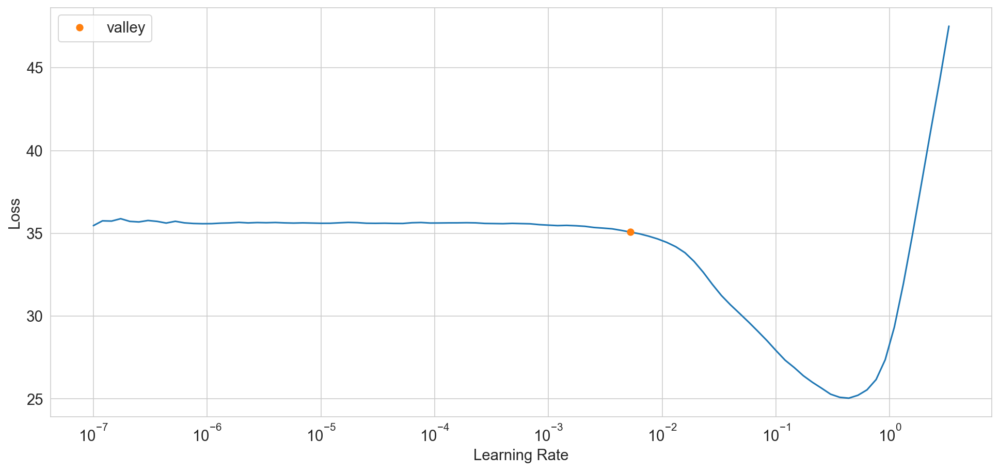

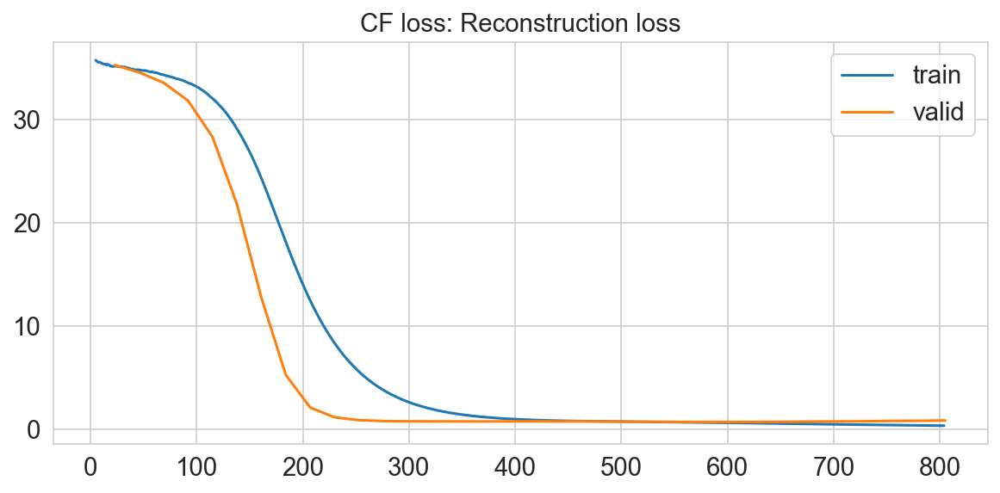

In [40]:
#impute missing values in a wide matrix df_filtered using PIMMSlearn collaborative filtering model.

#df_filtered : wide matrix (rows = samples, columns = features) with missing values to impute.
#epochs : maximum number of training epochs.
#run_locally : if True, change to local_run directory before fitting the model.

cf_imputed = impute_cf(
    log_transformed, 
    epochs=100, 
    run_locally=True, 
    non_train=0.3,
    n_factors=40,
    patience = 10)
cf_imputed

epoch,train_loss,valid_loss,time
0,1247.452759,137.590424,00:01
1,1238.574829,138.460571,00:00
2,1226.726318,139.458160,00:00
3,1217.187622,139.904160,00:00
4,1206.174194,141.903442,00:00
5,1193.981934,145.054382,00:01
6,1179.274780,145.642776,00:00
7,1164.099976,148.066818,00:00
8,1158.712036,148.279877,00:00
9,1146.232056,157.407578,00:01


No improvement since epoch 0: early stopping


Masked validation MSE: 0.639089


,,,,,,,,,,A0A075B6H9,A0A075B6I9,A0A075B6J1,A0A075B6J2,A0A075B6J9,A0A075B6K0,A0A075B6K2,A0A075B6K4,A0A075B6K5,A0A075B6K6,...,Q9Y608,Q9Y613,Q9Y624,Q9Y646,Q9Y696,Q9Y6C2,Q9Y6E0,Q9Y6N7,Q9Y6R7,Q9Y6Z7
label_id,group,AL_kode,plate_position,plate_nr,sample_name,sample_type,study_ID,timepoint,nan_fraction,,,,,,,,,,,,,,,,,,,,,
4083906373,Intervention,100005,A6,plate1,plate1_A6,sample,67.0,day_15,0.23409269442262373,18.166,27.971,19.381,18.717,24.582,22.917,17.391,25.921,27.589,17.478,...,17.186,17.855,19.936,16.091,16.631,14.234,18.581,13.647,23.325,22.755
4083918930,Intervention,100006,A7,plate1,plate1_A7,sample,34.0,day_0,0.3307148468185389,18.737,28.127,19.643,19.128,24.540,23.511,20.549,25.698,27.130,16.701,...,16.671,16.730,19.064,15.069,16.809,13.693,16.548,13.344,22.579,22.806
4083982663,Intervention,100007,A8,plate1,plate1_A8,sample,63.0,day_0,0.3110761979575805,19.465,27.434,20.554,19.235,24.771,23.757,18.880,26.319,28.013,17.834,...,16.770,16.696,18.799,15.652,16.887,13.431,16.992,13.592,22.136,21.723
4083907917,Control,100008,A9,plate1,plate1_A9,sample,16.0,day_15,0.25923016496465046,21.434,27.726,20.430,19.795,25.259,25.045,19.412,24.860,28.127,16.902,...,15.876,17.190,19.620,16.054,17.475,12.644,17.903,13.124,24.108,22.408
4083985725,Intervention,100009,A10,plate1,plate1_A10,sample,79.0,day_0,0.25608798114689707,18.840,27.027,21.868,20.117,24.548,25.056,19.963,24.727,28.029,17.075,...,16.401,16.914,20.202,15.999,17.061,13.622,18.081,13.442,23.052,22.695
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4083996660,Control,100153,E10,plate2,plate2_E10,sample,57.0,day_0,0.3063629222309505,20.170,27.885,20.635,18.808,25.149,24.279,20.008,24.984,27.700,16.332,...,16.338,17.021,18.361,16.697,16.712,13.010,16.808,13.277,22.146,22.921
4083980445,Intervention,100154,E11,plate2,plate2_E11,sample,79.0,day_15,0.30557737627651216,17.378,27.787,21.558,19.371,23.962,25.476,21.221,27.080,27.842,17.482,...,17.496,16.393,19.625,16.105,17.158,13.154,17.150,13.357,23.611,23.786
4083966190,Intervention,100155,E12,plate2,plate2_E12,sample,35.0,day_15,0.29772191673212883,17.733,27.488,22.985,19.003,24.807,24.947,18.671,26.143,27.805,14.975,...,18.571,16.814,17.806,16.094,17.155,13.425,17.554,12.993,25.306,23.720


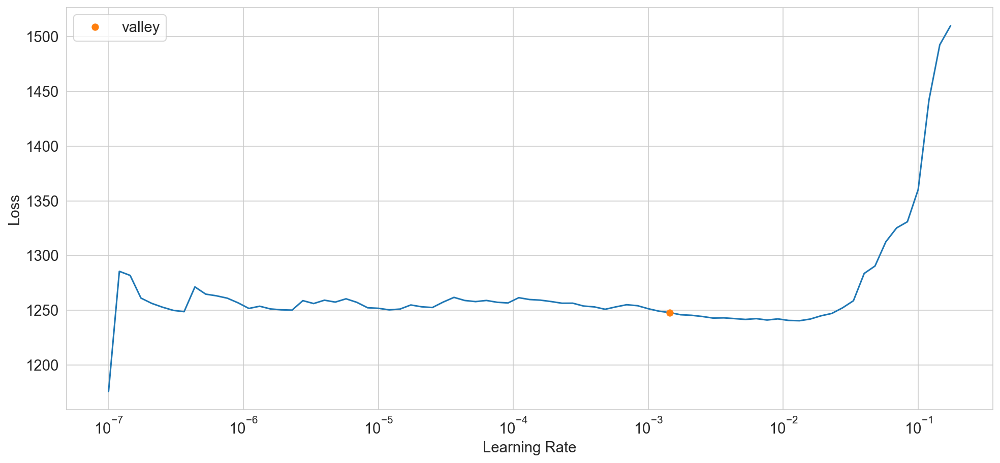

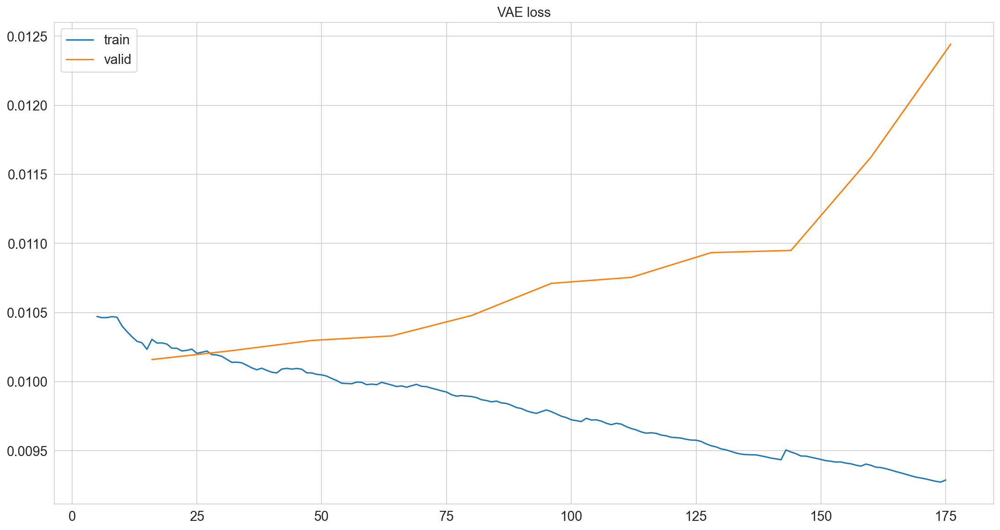

In [41]:
#impute missing values in a wide matrix df_filtered using a PIMMS VAE.

#df_filtered : wide matrix (rows = samples, columns = features) with missing values to impute.
#epochs : maximum number of training epochs.
#run_locally : if True, change to local_run directory before fitting the model.

vae_imputed= impute_vae(
    log_transformed, 
    epochs=50, 
    patience=10, 
    run_locally=True, 
    random_state= 42)
vae_imputed

epoch,train_loss,valid_loss,time
0,8323.160156,878.396667,00:00
1,7690.697266,1017.829895,00:00
2,7262.147461,888.135986,00:00
3,6795.465820,949.228821,00:00
4,6441.745605,1045.208984,00:00
5,6242.377930,1323.313110,00:00
6,6112.718750,1155.333374,00:00
7,5978.082031,1120.078247,00:00
8,5825.509277,1058.935791,00:00
9,5663.788574,1011.628601,00:00


No improvement since epoch 0: early stopping


Masked validation MSE: 0.774100


,,,,,,,,,,A0A075B6H9,A0A075B6I9,A0A075B6J1,A0A075B6J2,A0A075B6J9,A0A075B6K0,A0A075B6K2,A0A075B6K4,A0A075B6K5,A0A075B6K6,...,Q9Y608,Q9Y613,Q9Y624,Q9Y646,Q9Y696,Q9Y6C2,Q9Y6E0,Q9Y6N7,Q9Y6R7,Q9Y6Z7
label_id,group,AL_kode,plate_position,plate_nr,sample_name,sample_type,study_ID,timepoint,nan_fraction,,,,,,,,,,,,,,,,,,,,,
4083906373,Intervention,100005,A6,plate1,plate1_A6,sample,67.0,day_15,0.23409269442262373,18.166,27.003,19.381,18.717,24.582,22.917,17.391,25.921,28.256,17.478,...,17.186,17.855,19.936,15.676,16.631,14.234,18.581,13.488,23.325,22.962
4083918930,Intervention,100006,A7,plate1,plate1_A7,sample,34.0,day_0,0.3307148468185389,18.785,28.127,19.643,17.743,23.107,23.511,20.549,25.293,27.130,16.701,...,16.256,16.730,19.064,15.069,16.478,13.693,16.548,13.344,21.994,22.806
4083982663,Intervention,100007,A8,plate1,plate1_A8,sample,63.0,day_0,0.3110761979575805,18.621,27.448,21.412,19.730,25.419,23.757,18.880,26.319,28.013,17.595,...,16.651,16.696,18.799,15.652,16.887,13.411,16.992,13.592,22.136,21.723
4083907917,Control,100008,A9,plate1,plate1_A9,sample,16.0,day_15,0.25923016496465046,21.434,27.726,20.430,19.795,25.259,24.772,19.412,24.860,27.475,16.902,...,15.876,16.297,19.620,16.054,17.475,12.644,17.903,13.124,24.108,22.408
4083985725,Intervention,100009,A10,plate1,plate1_A10,sample,79.0,day_0,0.25608798114689707,18.840,26.496,21.868,20.117,25.140,25.056,19.963,24.727,28.636,17.075,...,16.401,16.813,20.202,16.116,17.008,13.622,18.081,13.442,23.052,23.376
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4083996660,Control,100153,E10,plate2,plate2_E10,sample,57.0,day_0,0.3063629222309505,20.170,27.885,20.635,18.808,25.149,24.279,20.008,24.984,27.700,16.332,...,15.795,17.021,18.361,16.697,16.712,13.010,17.009,13.277,22.146,22.921
4083980445,Intervention,100154,E11,plate2,plate2_E11,sample,79.0,day_15,0.30557737627651216,17.378,27.787,21.085,19.371,23.962,25.476,21.221,27.080,27.842,17.482,...,17.496,15.876,19.625,16.105,17.158,13.693,16.786,13.357,23.611,23.786
4083966190,Intervention,100155,E12,plate2,plate2_E12,sample,35.0,day_15,0.29772191673212883,17.733,27.488,22.985,20.268,24.864,24.947,18.671,25.796,27.805,14.975,...,18.571,16.814,17.806,16.705,17.056,13.425,17.554,12.993,25.306,23.720


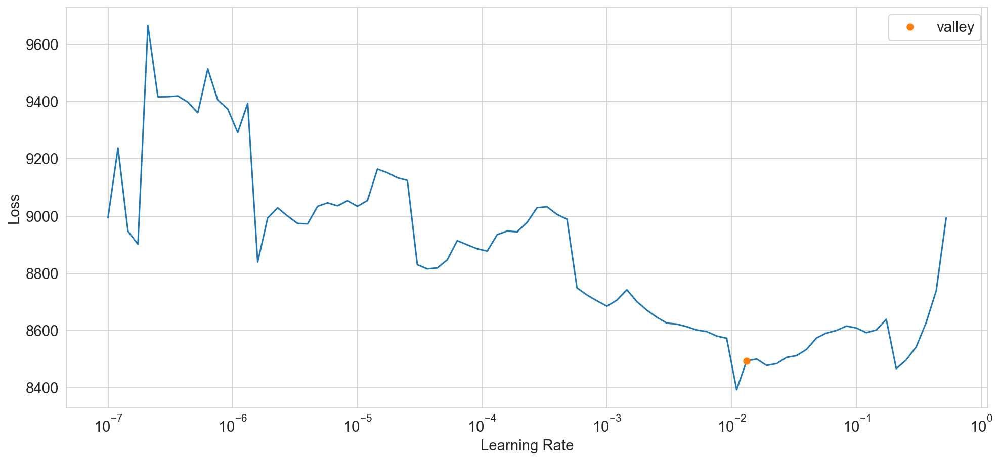

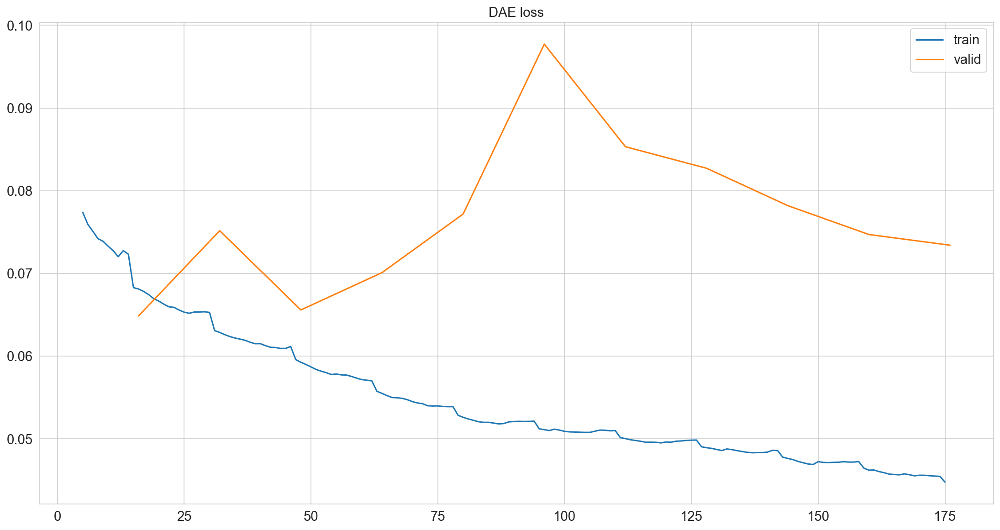

In [42]:
#impute missing values in a wide matrix df_filtered using a PIMMS DAE.

#df_filtered : wide matrix (rows = samples, columns = features) with missing values to impute.
#epochs : maximum number of training epochs.
#run_locally : if True, change to local_run directory before fitting the model.

dae_imputed= impute_dae(
    log_transformed, 
    epochs=50, 
    patience=10, 
    run_locally=True)
dae_imputed

In [42]:
#choose best imputation method
proteome_imputed = cf_imputed

In [44]:
plot_umap(proteome_imputed, color_by = "nan_fraction") 

c:\Users\aben0177\Documents\venvs\MSpreprocessing\Lib\site-packages\umap\umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



### Normalization

In [45]:
plot_umap(proteome_imputed, color_by = "plate_nr")

c:\Users\aben0177\Documents\venvs\MSpreprocessing\Lib\site-packages\umap\umap_.py:1952: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



In [ ]:
#install inmoose separately
from inmoose.pycombat import pycombat_norm

batch_corrected = pycombat_norm(proteome_imputed.T,proteome_imputed.reset_index()['plate_nr'].tolist()).T
batch_corrected

In [ ]:
plot_umap(batch_corrected, color_by = "plate_nr")

In [ ]:
ordered = get_sample_order(batch_corrected, plate_nr="plate_nr", plate_pos="plate_position")
ordered = ordered.sort_index(level="sample_order")
ordered

,,,,,,,,,,,A0A075B6H9,A0A075B6I9,A0A075B6J1,A0A075B6J2,A0A075B6J9,A0A075B6K0,A0A075B6K2,A0A075B6K4,A0A075B6K5,A0A075B6K6,...,Q9Y608,Q9Y613,Q9Y624,Q9Y646,Q9Y696,Q9Y6C2,Q9Y6E0,Q9Y6N7,Q9Y6R7,Q9Y6Z7
label_id,group,AL_kode,plate_position,plate_nr,sample_name,sample_type,study_ID,timepoint,nan_fraction,sample_order,,,,,,,,,,,,,,,,,,,,,
4083906373,Intervention,100005,A6,plate1,plate1_A6,sample,67.0,day_15,0.23409269442262373,1,18.166,27.003,19.381,18.717,24.582,22.917,17.391,25.921,28.256,17.478,...,17.186,17.855,19.936,15.676,16.631,14.234,18.581,13.488,23.325,22.962
4083918930,Intervention,100006,A7,plate1,plate1_A7,sample,34.0,day_0,0.3307148468185389,2,18.785,28.127,19.643,17.743,23.107,23.511,20.549,25.293,27.130,16.701,...,16.256,16.730,19.064,15.069,16.478,13.693,16.548,13.344,21.994,22.806
4083982663,Intervention,100007,A8,plate1,plate1_A8,sample,63.0,day_0,0.3110761979575805,3,18.621,27.448,21.412,19.730,25.419,23.757,18.880,26.319,28.013,17.595,...,16.651,16.696,18.799,15.652,16.887,13.411,16.992,13.592,22.136,21.723
4083907917,Control,100008,A9,plate1,plate1_A9,sample,16.0,day_15,0.25923016496465046,4,21.434,27.726,20.430,19.795,25.259,24.772,19.412,24.860,27.475,16.902,...,15.876,16.297,19.620,16.054,17.475,12.644,17.903,13.124,24.108,22.408
4083985725,Intervention,100009,A10,plate1,plate1_A10,sample,79.0,day_0,0.25608798114689707,5,18.840,26.496,21.868,20.117,25.140,25.056,19.963,24.727,28.636,17.075,...,16.401,16.813,20.202,16.116,17.008,13.622,18.081,13.442,23.052,23.376
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4083996660,Control,100153,E10,plate2,plate2_E10,sample,57.0,day_0,0.3063629222309505,148,20.170,27.885,20.635,18.808,25.149,24.279,20.008,24.984,27.700,16.332,...,15.795,17.021,18.361,16.697,16.712,13.010,17.009,13.277,22.146,22.921
4083980445,Intervention,100154,E11,plate2,plate2_E11,sample,79.0,day_15,0.30557737627651216,149,17.378,27.787,21.085,19.371,23.962,25.476,21.221,27.080,27.842,17.482,...,17.496,15.876,19.625,16.105,17.158,13.693,16.786,13.357,23.611,23.786
4083966190,Intervention,100155,E12,plate2,plate2_E12,sample,35.0,day_15,0.29772191673212883,150,17.733,27.488,22.985,20.268,24.864,24.947,18.671,25.796,27.805,14.975,...,18.571,16.814,17.806,16.705,17.056,13.425,17.554,12.993,25.306,23.720


In [50]:
plot_density_heatmap(ordered)

In [52]:
plot_sample_box(ordered)

In [54]:
plot_sample_means(ordered)

In [57]:
normalized = normalize_sample(ordered, method = "median")
normalized

,,,,,,,,,,,A0A075B6H9,A0A075B6I9,A0A075B6J1,A0A075B6J2,A0A075B6J9,A0A075B6K0,A0A075B6K2,A0A075B6K4,A0A075B6K5,A0A075B6K6,...,Q9Y608,Q9Y613,Q9Y624,Q9Y646,Q9Y696,Q9Y6C2,Q9Y6E0,Q9Y6N7,Q9Y6R7,Q9Y6Z7
label_id,group,AL_kode,plate_position,plate_nr,sample_name,sample_type,study_ID,timepoint,nan_fraction,sample_order,,,,,,,,,,,,,,,,,,,,,
4083906373,Intervention,100005,A6,plate1,plate1_A6,sample,67.0,day_15,0.23409269442262373,1,17.760,26.400,18.948,18.299,24.033,22.404,17.002,25.341,27.624,17.087,...,16.801,17.456,19.491,15.326,16.259,13.916,18.166,13.187,22.804,22.448
4083918930,Intervention,100006,A7,plate1,plate1_A7,sample,34.0,day_0,0.3307148468185389,2,18.806,28.158,19.665,17.762,23.133,23.537,20.572,25.321,27.161,16.720,...,16.274,16.749,19.086,15.086,16.496,13.708,16.566,13.359,22.018,22.832
4083982663,Intervention,100007,A8,plate1,plate1_A8,sample,63.0,day_0,0.3110761979575805,3,18.697,27.560,21.499,19.810,25.523,23.853,18.957,26.426,28.127,17.666,...,16.719,16.764,18.876,15.716,16.956,13.466,17.061,13.647,22.227,21.812
4083907917,Control,100008,A9,plate1,plate1_A9,sample,16.0,day_15,0.25923016496465046,4,21.191,27.411,20.198,19.571,24.972,24.491,19.192,24.577,27.163,16.710,...,15.696,16.112,19.398,15.872,17.277,12.500,17.700,12.975,23.834,22.154
4083985725,Intervention,100009,A10,plate1,plate1_A10,sample,79.0,day_0,0.25608798114689707,5,18.598,26.155,21.587,19.858,24.816,24.733,19.707,24.409,28.268,16.856,...,16.190,16.597,19.942,15.909,16.789,13.447,17.849,13.270,22.755,23.075
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4083996660,Control,100153,E10,plate2,plate2_E10,sample,57.0,day_0,0.3063629222309505,148,19.997,27.647,20.459,18.647,24.934,24.071,19.837,24.770,27.464,16.192,...,15.660,16.876,18.204,16.554,16.569,12.899,16.863,13.164,21.957,22.726
4083980445,Intervention,100154,E11,plate2,plate2_E11,sample,79.0,day_15,0.30557737627651216,149,17.401,27.823,21.113,19.396,23.994,25.509,21.249,27.115,27.878,17.504,...,17.519,15.896,19.650,16.126,17.181,13.710,16.807,13.375,23.642,23.817
4083966190,Intervention,100155,E12,plate2,plate2_E12,sample,35.0,day_15,0.29772191673212883,150,17.754,27.521,23.013,20.292,24.894,24.977,18.693,25.827,27.838,14.993,...,18.594,16.834,17.827,16.725,17.077,13.441,17.575,13.008,25.336,23.748


In [58]:
plot_sample_means(normalized)

In [59]:
#save preprocessed data
normalized.to_csv("preprocessed_data.tsv", sep="\t")